# OpenCV (Open Source Computer Vision)

Open cv is a computer vision library that provides set of tools for image and video processing

### Key features
1. Image Processing: Filtering, transformations and morphological operations
2. Computer Vision algorithms: The library has more than 2500 optimized algorithms for object detection, object tracking, feature detection and image stiching
3. OpenCV is written in c++. You can find the source code [here](https://github.com/opencv/opencv)

#### This notebook was last updated on 15 November 2023

## Content:
1. [Images in OpenCV (Reading, Saving, Cropping, colour spaces)](#1)
1. [Accessing camera](#2)
1. [Reading videos](#3)
1. [image annotations](#4)
1. [Scaling, re-sizing and interpolations](#13)
1. [Image Thresholding](#5)
1. [Adaptive Thresholding](#6)
1. [Otsu's Binarization](#7)
1. [Edge Detection, countors & Image Gradients](#8)
1. [Image enhancement](#9)
1. [Perpsective Transform](#10)
1. [Image filters - Blur, Features, Canny](#11)
1. [Image stiching](#12)
1. [Bitwise operations](#14)
1. [Histogram computation](#15)
1. [Histogram computation](#16)


<a id="1"></a> 
# **1. Images in OpenCV and colour channels**

Getting started with images

- we will use matplotlib for displaying images *.imshow()*
- %matplotlib inline allows the output of plotting commands to be displayed directly below the code cell that produced it. It is commonly used in data science and image processing workflows within Jupyter Notebooks.
- IPython.display.Image class is used for displaying images in the IPython environment, which includes Jupyter Notebooks. It allows you to embed images directly in the notebook output.

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import Image

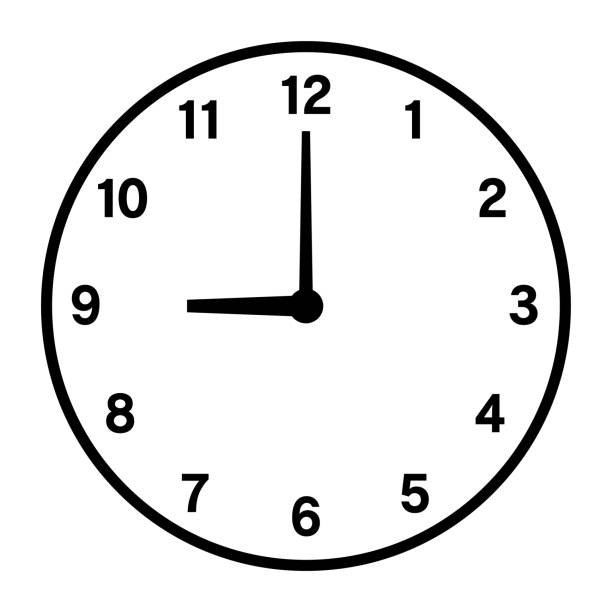

In [2]:
#Display image using IPython.display.Image class

Image(filename="/kaggle/input/sampleopencvmediafiles/media/clock.jpg")

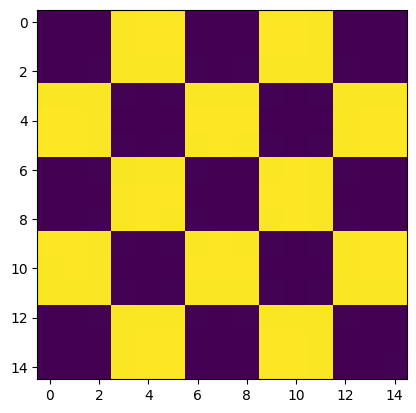

In [3]:
#Read image using cv2
cb1818 = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/cb1818.jpg",0)

#Display image using matplotlib.pyplot.imshow class
plt.imshow(cb1818)

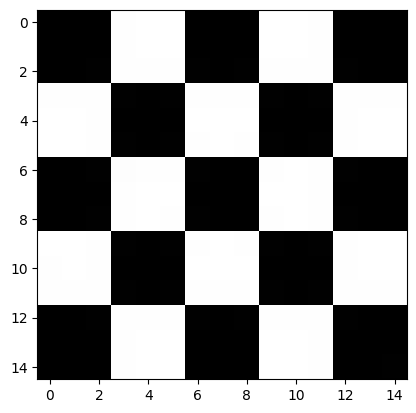

In [4]:
#Read image using cv2
cb1818 = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/cb1818.jpg",0)

#Display image using matplotlib.pyplot.imshow class
plt.imshow(cb1818, cmap="gray")

In [5]:
print(cb1818)

[[  0   0   0 254 255 255   0   0   0 255 255 254   0   0   0]
 [  0   0   0 254 255 255   0   0   0 255 255 254   0   0   0]
 [  0   0   1 254 254 254   1   0   1 254 254 254   1   0   0]
 [254 254 254   1   0   1 254 254 254   1   0   1 254 254 254]
 [255 255 254   0   0   0 255 255 255   0   0   0 254 255 255]
 [255 255 254   1   0   1 254 255 254   1   0   1 254 255 255]
 [  0   0   1 253 254 254   1   0   0 254 255 254   1   0   0]
 [  0   0   0 254 255 255   0   0   0 255 255 254   0   0   0]
 [  0   0   1 254 255 254   1   0   0 254 255 254   1   0   0]
 [255 255 254   1   0   1 254 255 254   1   0   1 254 255 255]
 [254 255 254   0   0   0 255 255 255   0   0   0 254 255 255]
 [254 254 254   1   0   1 254 254 254   1   0   1 254 254 254]
 [  0   0   1 254 254 254   1   0   1 254 254 254   1   0   0]
 [  0   0   0 254 255 255   0   0   0 255 255 254   0   0   0]
 [  0   0   0 254 255 255   0   0   0 255 255 254   0   0   1]]


As we can see above, when we print the image variable we read from cv2.imread() it shows a numpy array woth values ranging from 0-225. They represent the intensity of the colour in a particular region

### Updating individual pixles

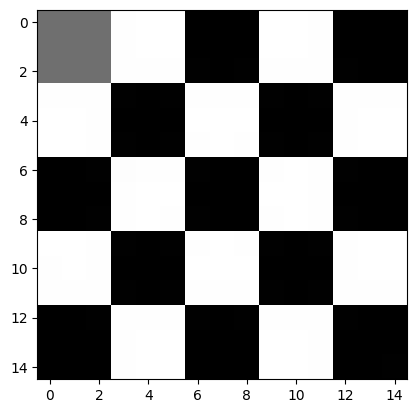

In [6]:
cb_copy = cb1818.copy()

# Updating inddividual pixles using list slicing
cb_copy[0:3,0:3] = 111
plt.imshow(cb_copy, cmap="gray")

In [7]:
# Now if we print the numpy array...

print(cb_copy)

[[111 111 111 254 255 255   0   0   0 255 255 254   0   0   0]
 [111 111 111 254 255 255   0   0   0 255 255 254   0   0   0]
 [111 111 111 254 254 254   1   0   1 254 254 254   1   0   0]
 [254 254 254   1   0   1 254 254 254   1   0   1 254 254 254]
 [255 255 254   0   0   0 255 255 255   0   0   0 254 255 255]
 [255 255 254   1   0   1 254 255 254   1   0   1 254 255 255]
 [  0   0   1 253 254 254   1   0   0 254 255 254   1   0   0]
 [  0   0   0 254 255 255   0   0   0 255 255 254   0   0   0]
 [  0   0   1 254 255 254   1   0   0 254 255 254   1   0   0]
 [255 255 254   1   0   1 254 255 254   1   0   1 254 255 255]
 [254 255 254   0   0   0 255 255 255   0   0   0 254 255 255]
 [254 254 254   1   0   1 254 254 254   1   0   1 254 254 254]
 [  0   0   1 254 254 254   1   0   1 254 254 254   1   0   0]
 [  0   0   0 254 255 255   0   0   0 255 255 254   0   0   0]
 [  0   0   0 254 255 255   0   0   0 255 255 254   0   0   1]]


We can observe the top left corner of the checker board has turned into the color we specified (111 colour intensity)

## Image cropping

### OpenCV reads images in BGR format 

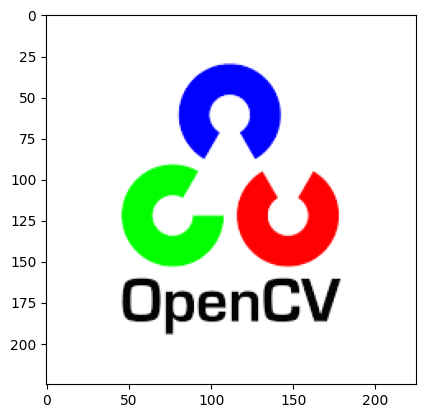

In [8]:
colourImage = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/opencv.png",1)
plt.imshow(colourImage)

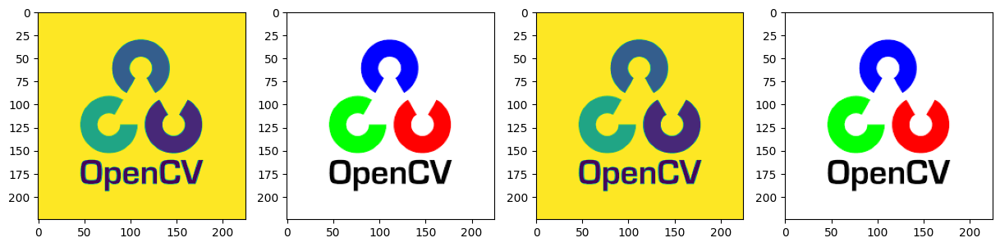

In [9]:
plt.figure(figsize=[15,10])

plt.subplot(1,4,1); plt.imshow(cv2.imread("/kaggle/input/sampleopencvmediafiles/media/opencv.png",0));
plt.subplot(1,4,2); plt.imshow(cv2.imread("/kaggle/input/sampleopencvmediafiles/media/opencv.png",1));
plt.subplot(1,4,3); plt.imshow(cv2.imread("/kaggle/input/sampleopencvmediafiles/media/opencv.png",2));
plt.subplot(1,4,4); plt.imshow(cv2.imread("/kaggle/input/sampleopencvmediafiles/media/opencv.png",3));

## Splitting and merging colour channels

Text(0.5, 1.0, 'Also RGB Image')

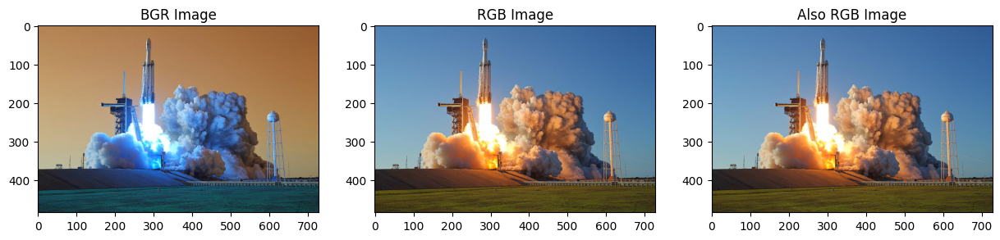

In [10]:
falcon_9_image_bgr = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/falcon9.jpg")
falcon_9_image_rgb = cv2.cvtColor(falcon_9_image_bgr, cv2.COLOR_BGR2RGB)
falcon_9_image_rgb_list = falcon_9_image_bgr[:,:,::-1]    # we can reverse the colour channels bgr ro rbg using list slicing

plt.figure(figsize=[15,10])

plt.subplot(131); plt.imshow(falcon_9_image_bgr); plt.title("BGR Image")
plt.subplot(132); plt.imshow(falcon_9_image_rgb); plt.title("RGB Image")
plt.subplot(133); plt.imshow(falcon_9_image_rgb_list); plt.title("Also RGB Image")

Text(0.5, 1.0, 'Merged Image')

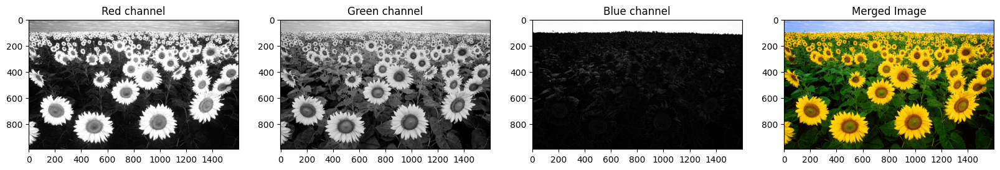

In [11]:
bgr_img = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/flower.png")
b, g, r = cv2.split(bgr_img)

plt.figure(figsize=[20,5])

plt.subplot(141); plt.imshow(r, cmap='gray'); plt.title("Red channel")
plt.subplot(142); plt.imshow(g, cmap='gray'); plt.title("Green channel")
plt.subplot(143); plt.imshow(b, cmap='gray'); plt.title("Blue channel")

mergedImg = cv2.merge((b, g, r))
plt.subplot(144); plt.imshow(mergedImg[:,:,::-1]); plt.title("Merged Image")

```
b, g, r = cv2.split(bgr_img)
```

This line splits the colour channels in the cv2.imread() variable into blue, green and red. 

- OpenCV reads the image in the order of BLUE-GREEN-RED insted of RED-GREEN-BLUE 
- So sometimes when we want to display a colour image we do [: , : , : : -1] to the image variable or we can add cv2.BGR2RGB in the colour channel argument

Text(0.5, 1.0, 'Red channel + 30')

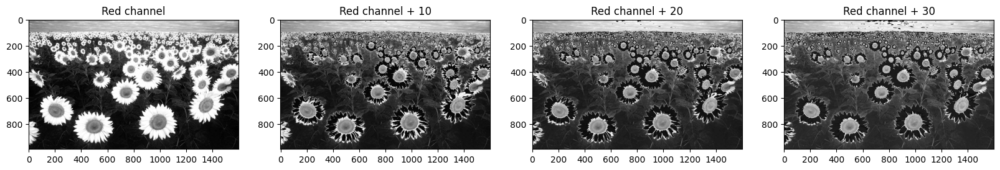

In [12]:
# Experimenting with adjusting intensities of channels

plt.figure(figsize=[20,5])
plt.subplot(141); plt.imshow(r, cmap='gray'); plt.title("Red channel")
plt.subplot(142); plt.imshow(r+10, cmap='gray'); plt.title("Red channel + 10")
plt.subplot(143); plt.imshow(r+20, cmap='gray'); plt.title("Red channel + 20")
plt.subplot(144); plt.imshow(r+30, cmap='gray'); plt.title("Red channel + 30")

Text(0.5, 1.0, 'Blue channel + 30')

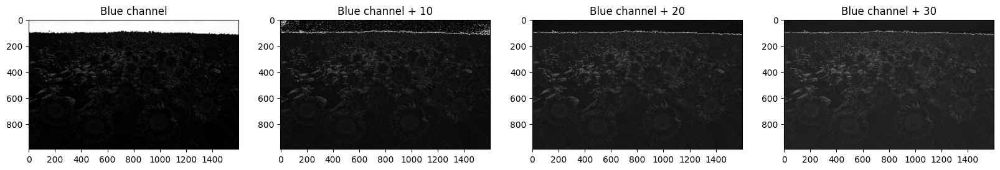

In [13]:
plt.figure(figsize=[20,5])
plt.subplot(141); plt.imshow(b, cmap='gray'); plt.title("Blue channel")
plt.subplot(142); plt.imshow(b+10, cmap='gray'); plt.title("Blue channel + 10")
plt.subplot(143); plt.imshow(b+20, cmap='gray'); plt.title("Blue channel + 20")
plt.subplot(144); plt.imshow(b+30, cmap='gray'); plt.title("Blue channel + 30")

Text(0.5, 1.0, 'Greem channel + 30')

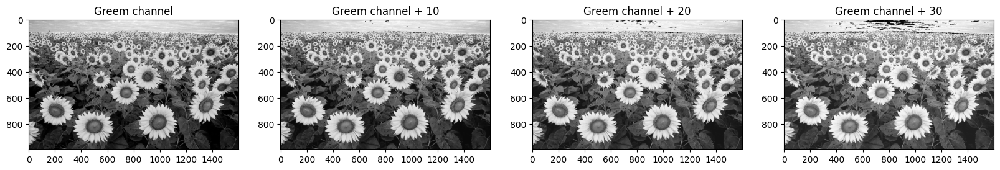

In [14]:
plt.figure(figsize=[20,5])
plt.subplot(141); plt.imshow(g, cmap='gray'); plt.title("Greem channel")
plt.subplot(142); plt.imshow(g+10, cmap='gray'); plt.title("Greem channel + 10")
plt.subplot(143); plt.imshow(g+20, cmap='gray'); plt.title("Greem channel + 20")
plt.subplot(144); plt.imshow(g+30, cmap='gray'); plt.title("Greem channel + 30")

Text(0.5, 1.0, 'Plus 30')

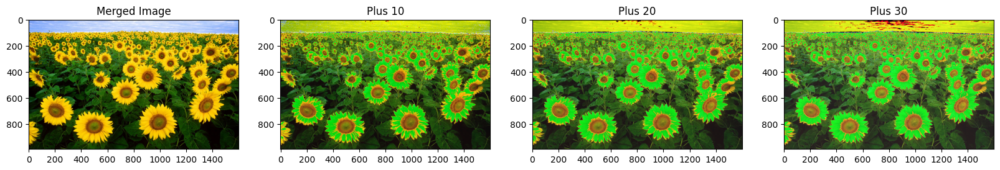

In [15]:
plt.figure(figsize=[20,5])

mergedImg = cv2.merge((b, g, r))
plt.subplot(141); plt.imshow(mergedImg[:,:,::-1]); plt.title("Merged Image")

mergedImg1 = cv2.merge((b+10, g+10, r+10))
plt.subplot(142); plt.imshow(mergedImg1[:,:,::-1]); plt.title("Plus 10")

mergedImg2 = cv2.merge((b+20, g+20, r+20))
plt.subplot(143); plt.imshow(mergedImg2[:,:,::-1]); plt.title("Plus 20")

mergedImg3 = cv2.merge((b+30, g+30, r+30))
plt.subplot(144); plt.imshow(mergedImg3[:,:,::-1]); plt.title("Plus 30")

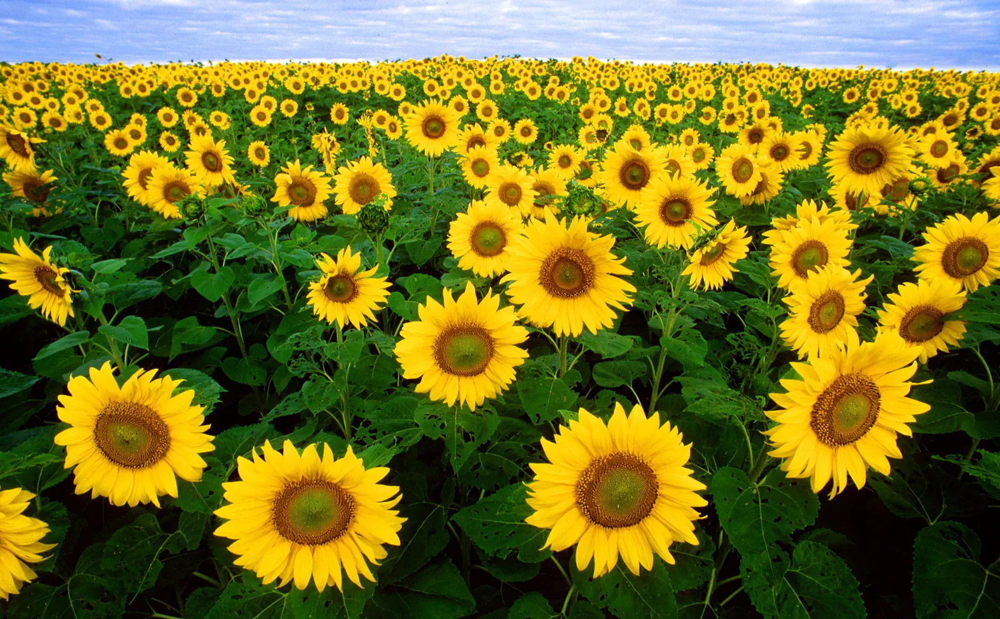

In [16]:
cv2.imwrite("ResizedCroppedImg.png", mergedImg)
# Image is saved in the output

Image(filename="ResizedCroppedImg.png")

### Color spaces

Text(0.5, 1.0, 'BGR to LAB')

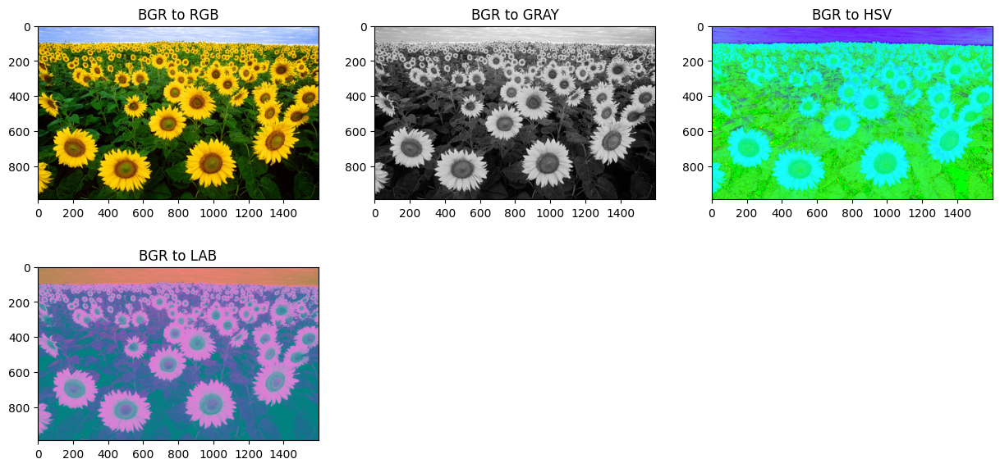

In [17]:
colourFlowerImage = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/flower.png")

plt.figure(figsize=[15,7])
plt.subplot(2,3,1); plt.imshow(cv2.cvtColor(colourFlowerImage, cv2.COLOR_BGR2RGB)); plt.title("BGR to RGB")
plt.subplot(2,3,2); plt.imshow(cv2.cvtColor(colourFlowerImage, cv2.COLOR_BGR2GRAY), cmap="gray"); plt.title("BGR to GRAY")
plt.subplot(2,3,3); plt.imshow(cv2.cvtColor(colourFlowerImage, cv2.COLOR_BGR2HSV)); plt.title("BGR to HSV")
plt.subplot(2,3,4); plt.imshow(cv2.cvtColor(colourFlowerImage, cv2.COLOR_BGR2LAB)); plt.title("BGR to LAB")

<a id="2"></a> 
# **2. Accessing Camera**

To access the camera in opencv we fllow these steps:

- Create a VideoCapture object to capture video from the camera.
- Check if the camera is opened successfully.
- Read the frames from the camera.
- Display the frames on the screen.
- Release the camera when you are finished.

In [18]:
#We can use this python script to preview the camera output, but this might not work in kaggle/jupyter notebook env

import sys
import cv2

s=0
if len(sys.argv) > 1:
    s = sys.argv[1]    #If your system has more than one cameras, this function will choose the primiary camera

# source = cv2.VideoCapture(s)

# win_name = "Camera Preview"
# cv2.namedWindow(win_name, cv2.WINDOW_NORMAL)

# while cv2.waitKey(1) != 27:
#     has_frame, frame = source.read()
#     if not has_frame:
#         break
#     cv2.imshow(win_name, frame)

# source.release()
# cv2.destroyWindow(win_name)

<a id="3"></a> 
# **3. Reading videos**

In [19]:
source = "/kaggle/input/sampleopencvmediafiles/media/car.mp4"

cap = cv2.VideoCapture(source)

if (cap.isOpened == False):
    print("Error playing the video")

### Read and display one frame

Text(0.5, 1.0, 'First frame of the video')

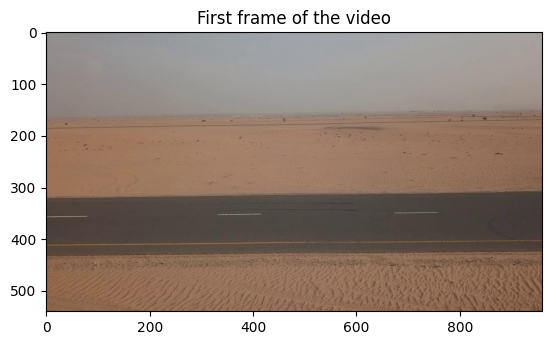

In [20]:
ret, frame = cap.read()

plt.imshow(frame[...,::-1]); plt.title("First frame of the video")

### Display the video from the file in browser using IPthon.display.HTML class

In [21]:
from IPython.display import HTML

HTML(
    """
    <video width=1024 controls>
        <source src="/kaggle/input/sampleopencvmediafiles/media/car.mp4" type="video/mp4">
    </video>
    """
)

<a id="4"></a> 
# **4. Image Annotation**

## Annoting images
- Draw lines
- Draw Circles
- Draw rectangles
- Add Text

### Add lines

Text(0.5, 1.0, 'Our base image')

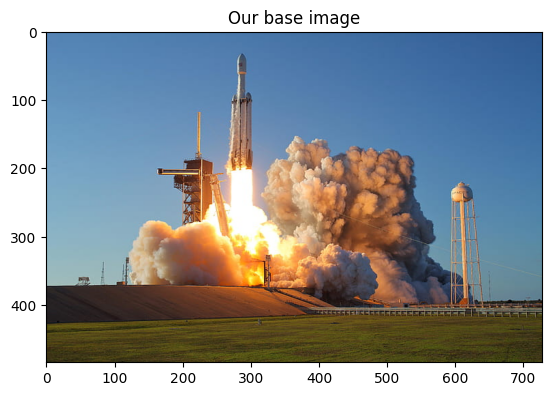

In [22]:
falcon9 = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/falcon9.jpg")
falcon9 = falcon9[:,:,::-1]

plt.imshow(falcon9); plt.title("Our base image")

## Adding Lines

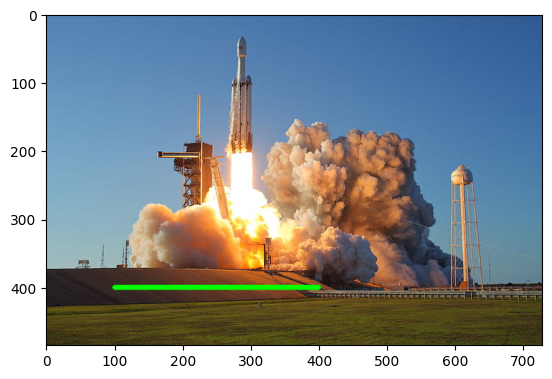

In [23]:
imgline = falcon9.copy()  #Create a copy of the base image to experiment

cv2.line(imgline, (100, 400), (400, 400), (0,2225,0), thickness=5, lineType=cv2.LINE_AA)

plt.imshow(imgline)

## Adding Circles

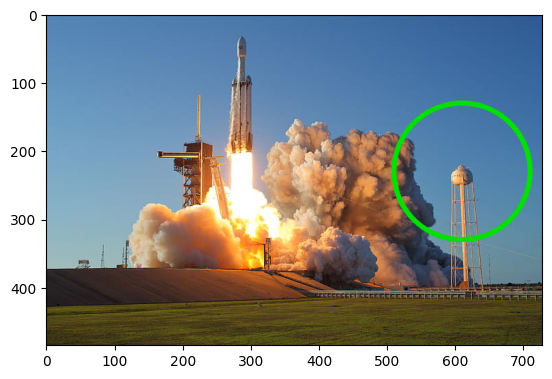

In [24]:
imgcircle = falcon9.copy()

cv2.circle(imgcircle, (610,230), 100, (0,225,0), thickness=5, lineType=cv2.LINE_AA)
plt.imshow(imgcircle)

## Adding Rectangles

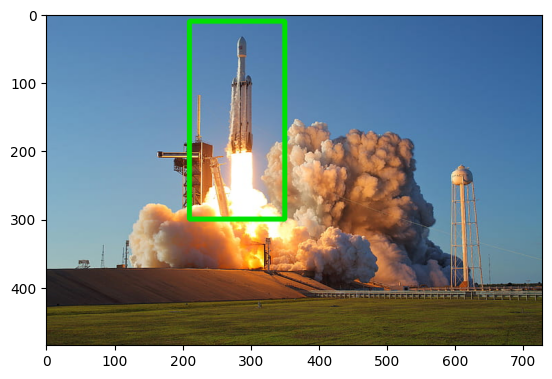

In [25]:
imgrectangle = falcon9.copy()

cv2.rectangle(imgrectangle, (210,10), (350,300), (0,225,0), thickness=5, lineType=cv2.LINE_AA)
plt.imshow(imgrectangle)

## Adding text to images

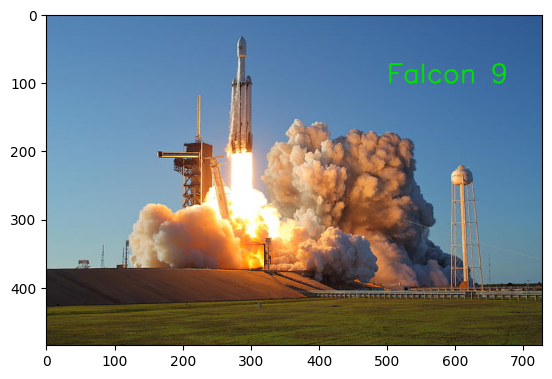

In [26]:
imgtext = falcon9.copy()

text = "Falcon 9"
fontcolor = (0,225,0)
fontthickness = 2
fontscale = 1.3
fontface = cv2.FONT_ITALIC

cv2.putText(imgtext, text, (500,100), fontface, fontscale, fontcolor, fontthickness)
plt.imshow(imgtext)

<a id="13"></a> 
# **4. Scaling, re-sizing and interpolations**

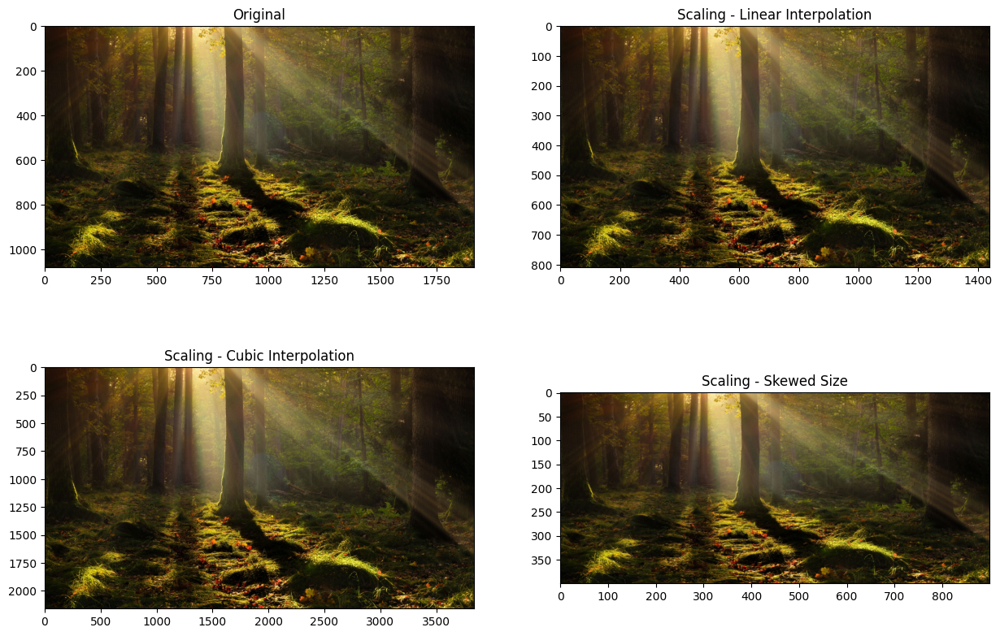

In [27]:
image = cv2.imread('/kaggle/input/sampleopencvmediafiles/media/forest.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1); plt.title("Original"); plt.imshow(image)

# rescale our image 3/4 of it's original size
image_scaled = cv2.resize(image, None, fx=0.75, fy=0.75)

plt.subplot(2, 2, 2); plt.title("Scaling - Linear Interpolation"); plt.imshow(image_scaled)

# Double the size of our image
img_scaled = cv2.resize(image, None, fx=2, fy=2, interpolation = cv2.INTER_CUBIC)

plt.subplot(2, 2, 3); plt.title("Scaling - Cubic Interpolation"); plt.imshow(img_scaled)

# skew the re-sizing by setting exact dimensions
img_scaled = cv2.resize(image, (900, 400), interpolation = cv2.INTER_AREA)

plt.subplot(2, 2, 4); plt.title("Scaling - Skewed Size"); plt.imshow(img_scaled)

Text(0.5, 1.0, 'Cropped Image')

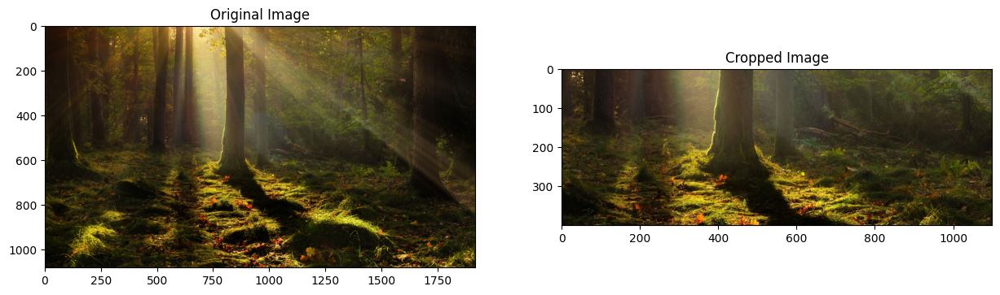

In [28]:
croppedimg = image[400:800, 400:1500]

plt.figure(figsize=[15,10])

plt.subplot(1, 2, 1); plt.imshow(image); plt.title('Original Image')
plt.subplot(1, 2, 2); plt.imshow(croppedimg); plt.title('Cropped Image')

## Methods for resizing images:

### method1: specifying scaling factor fx and fy

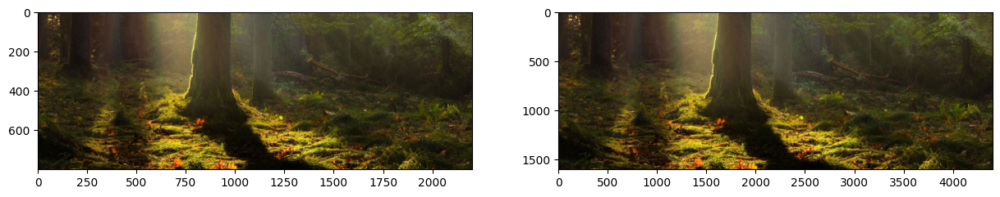

In [29]:
resized_cropped_img1 = cv2.resize(croppedimg, None, fx=2, fy=2)
resized_cropped_img2 = cv2.resize(croppedimg, None, fx=4, fy=4)

plt.figure(figsize=[15,10])

plt.subplot(1,2,1); plt.imshow(resized_cropped_img1)
plt.subplot(1,2,2); plt.imshow(resized_cropped_img2)

## Method 2: Specifying the exact size of the output image

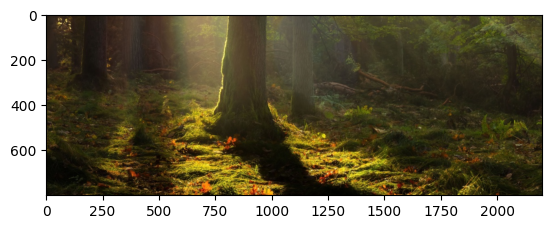

In [30]:
width = 2200
height = 800
dim = (width, height)

resized_cropped_img_with_dimentions = cv2.resize(croppedimg, dsize=dim)
plt.imshow(resized_cropped_img_with_dimentions)

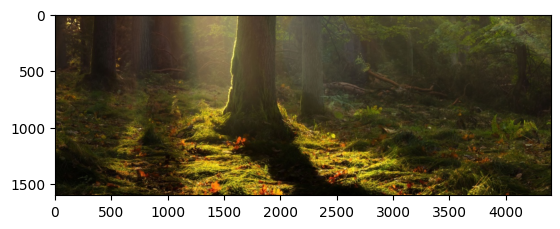

In [31]:
plt.imshow(cv2.resize(croppedimg, (4400, 1600)))

## Resizing while maintaining aspect ration (Important)

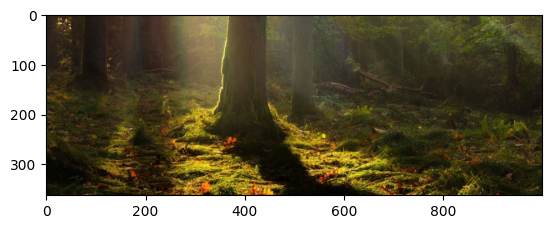

In [32]:
desiredWidth = 1000

aspectRatio = desiredWidth/croppedimg.shape[1]

desiredHight = int(croppedimg.shape[0] * aspectRatio)
dim = (desiredWidth, desiredHight)

resizedCroppedRegion = cv2.resize(croppedimg, dsize=dim)
plt.imshow(resizedCroppedRegion)

In [33]:
def resize_and_show_image(width, image):
    """
    Resize and display an image using OpenCV and Matplotlib.

    Parameters:
    - width (int): The desired width of the output image after resizing.
    - image (numpy.ndarray): The input image to be resized and displayed.

    Returns:
    None

    Example:
    ```
    import cv2
    import matplotlib.pyplot as plt

    # Assuming croppedimg is the image you want to resize and show
    hemp(500, croppedimg)
    ```
    """

    desiredWidth = width

    # Calculate the aspect ratio to maintain the image's proportions
    aspectRatio = desiredWidth / image.shape[1]
    
    # Calculate the desired height based on the aspect ratio
    desiredHeight = int(image.shape[0] * aspectRatio)
    dim = (desiredWidth, desiredHeight)
    
    # Resize the input image
    resizedImage = cv2.resize(image, dsize=dim)

    # Display the resized image using Matplotlib
    plt.imshow(resizedImage)
    plt.show()


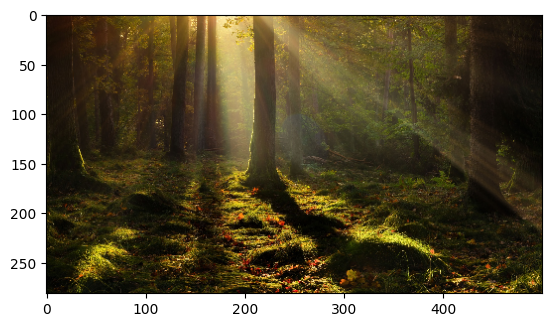

In [34]:
resize_and_show_image(500, image)

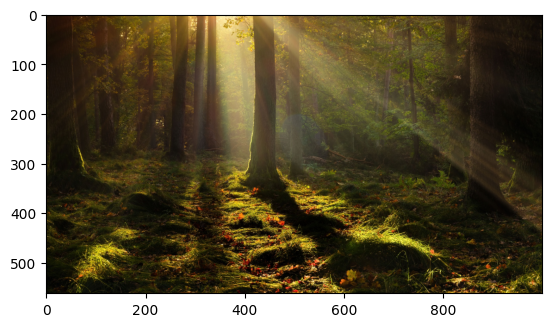

In [35]:
resize_and_show_image(1000, image)

<a id="5"></a> 
# **5. Image Thresholding**

Thresholding involves comparing each pixel's intensity value to a specified threshold. Pixels with intensity values greater than the threshold are set to a maximum value (commonly 255 for 8-bit images), while those below the threshold are set to zero. There are various thresholding methods, such as binary thresholding, adaptive thresholding, etc.Thresholding involves comparing each pixel's intensity value to a specified threshold. Pixels with intensity values greater than the threshold are set to a maximum value (commonly 255 for 8-bit images), while those below the threshold are set to zero. There are various thresholding methods, such as binary thresholding, adaptive thresholding, etc.


- Helps to create binary segmentation
- This allows to selectively modify the portions of the image while leaving other portions intact- Helps to create binary segmentation
- This allows to selectively modify the portions of the image while leaving other portions intact

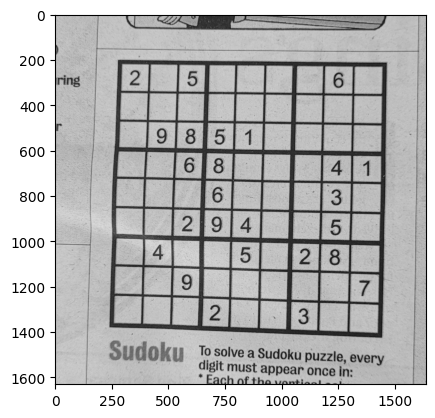

In [36]:
img = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/img.jpg", cv2.IMREAD_GRAYSCALE)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

cv2.imwrite("qoh.jpg",img)
plt.imshow(img)

Text(0.5, 1.0, 'After threasholding Image')

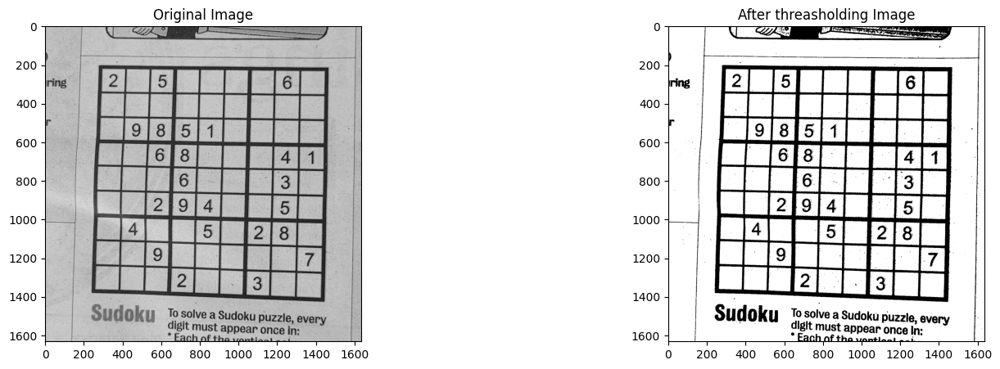

In [37]:
retreval, img_threash = cv2.threshold(img, 150, 255, cv2.THRESH_BINARY)

plt.figure(figsize=[18,5])
plt.subplot(121);plt.imshow(img, cmap="gray");    plt.title("Original Image")
plt.subplot(122);plt.imshow(img_threash, cmap="gray");    plt.title("After threasholding Image")

Text(0.5, 1.0, 'Threashold (global 150)')

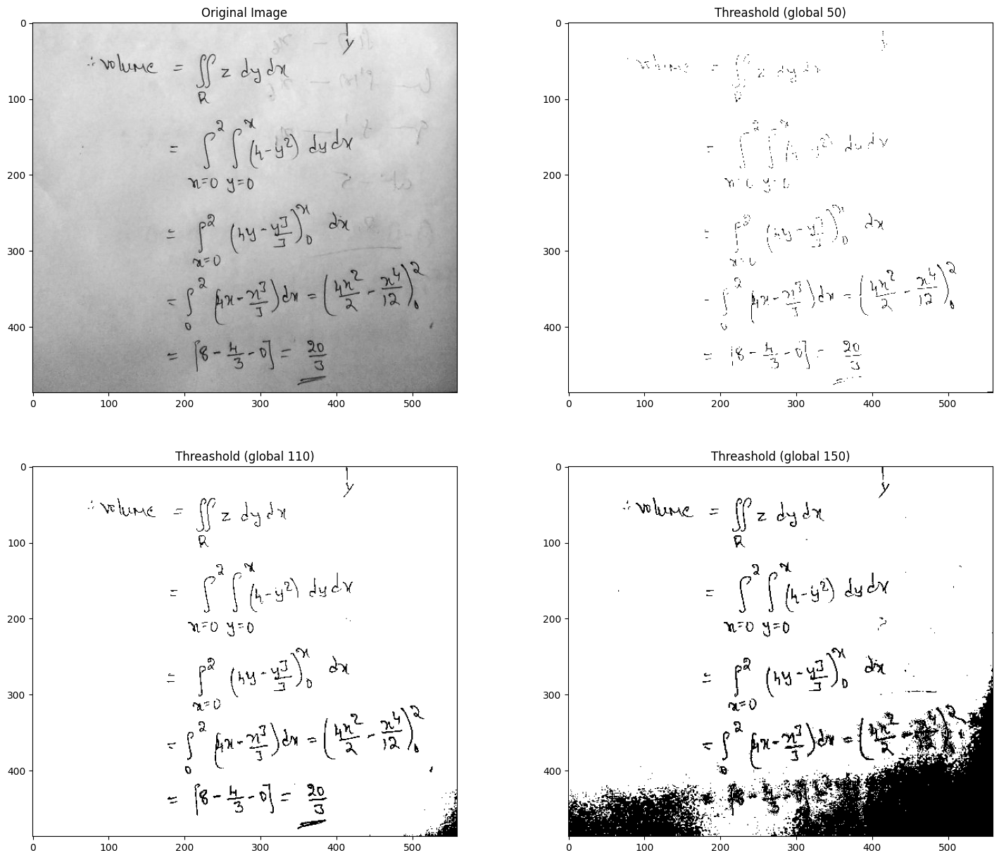

In [38]:
paper = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/tripleIntegration.png", cv2.THRESH_BINARY)

retrival1, paper_threash50 = cv2.threshold(paper, 50, 255, cv2.THRESH_BINARY)
retrival2, paper_threash110 = cv2.threshold(paper, 110, 255, cv2.THRESH_BINARY)
retrival3, paper_threash150 = cv2.threshold(paper, 150, 255, cv2.THRESH_BINARY)

plt.figure(figsize=[18,15])
plt.subplot(221); plt.imshow(paper, cmap="gray"); plt.title("Original Image")
plt.subplot(222); plt.imshow(paper_threash50, cmap="gray"); plt.title("Threashold (global 50)")
plt.subplot(223); plt.imshow(paper_threash110, cmap="gray"); plt.title("Threashold (global 110)")
plt.subplot(224); plt.imshow(paper_threash150, cmap="gray"); plt.title("Threashold (global 150)")

I the pixle value in the image is below a threshold value, we set the pixle intensity to zero. And if the pixle value is greater than threshold, we set the pixle value to a user defined pixle intensity (usually 225, maximun intnsity)

<a id="6"></a> 
# **6. Adaptive Thresholding**

In adaptive thresholding, a small region around each pixel is used to calculate a local threshold. The threshold value is then applied to the corresponding pixel, creating a binary image. This approach is effective in handling variations in illumination, shadows, and other local conditions.

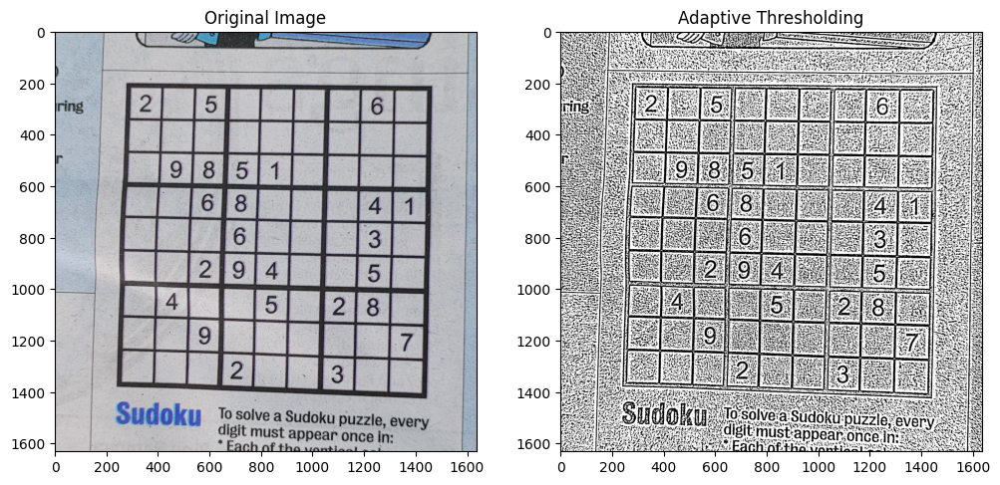

In [39]:
img = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/img.jpg")
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  

block_size = 11
constant = 2
adaptive_threshold = cv2.adaptiveThreshold(gray_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, block_size, constant)

plt.figure(figsize=(12, 6))

plt.subplot(121); plt.imshow(img, cmap="gray"); plt.title("Original Image")  
plt.subplot(122); plt.imshow(adaptive_threshold, cmap="gray"); plt.title("Adaptive Thresholding")
plt.show()

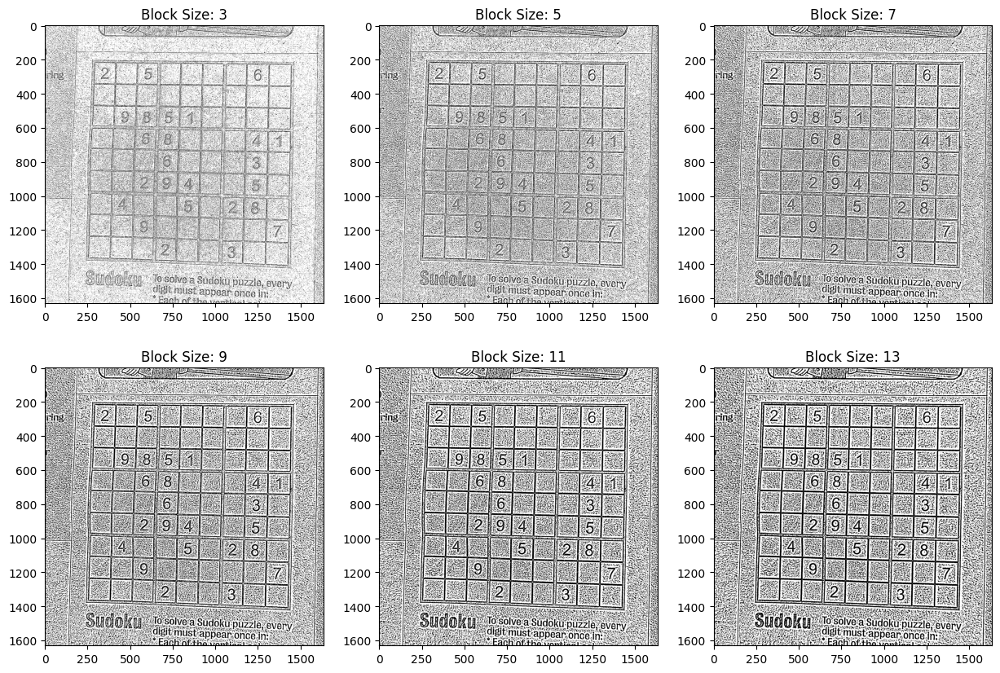

In [40]:
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

blockSizes = [3, 5, 7, 9, 11, 13]

plt.figure(figsize=[15, 10])

x = 1

for block in blockSizes:
    plt.subplot(2, 3, x)
    plt.imshow(cv2.adaptiveThreshold(gray_img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, block, constant), cmap="gray")
    plt.title("Block Size: {}".format(block))
    x += 1

plt.show()

<a id="7"></a> 
# **7. Otsu's Binarization**

Otsu's Binarization is a image processing technique used for automatic threshold selection in image segmentation

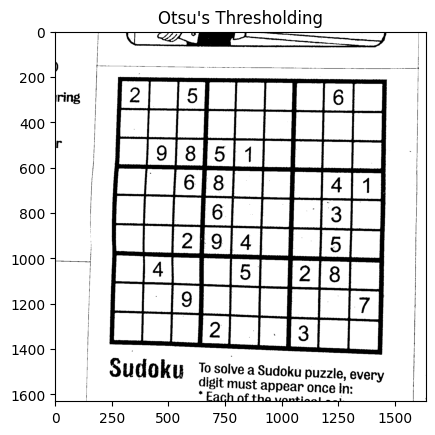

In [41]:
gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
Otsu = cv2.threshold(gray_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

plt.title("Otsu's Thresholding")
plt.imshow(Otsu, cmap="gray")

<a id="8"></a> 
# **8. Edge Detection & Image Gradients**


#### Note: Gradients and edges are completly different concepts from a mathematical point of view, but we can get away with treating edges as gradients with programming perspective only#### Note: Gradients and edges are completly different concepts from a mathematical point of view, but we can get away with treating edges as gradients with programming perspective only

### 1. method 1: Using canny edge detection

Text(0.5, 1.0, 'Base Image')

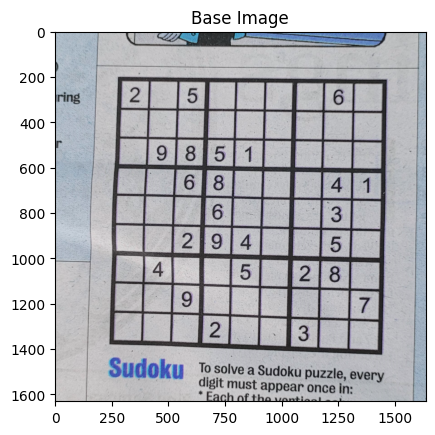

In [42]:
plt.imshow(img); plt.title('Base Image')

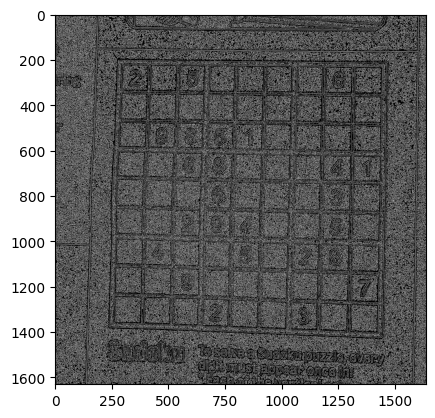

In [43]:
low = 10

cannySudokuImage = cv2.Canny(img, low, low+10)
plt.imshow(cannySudokuImage, cmap="gray")

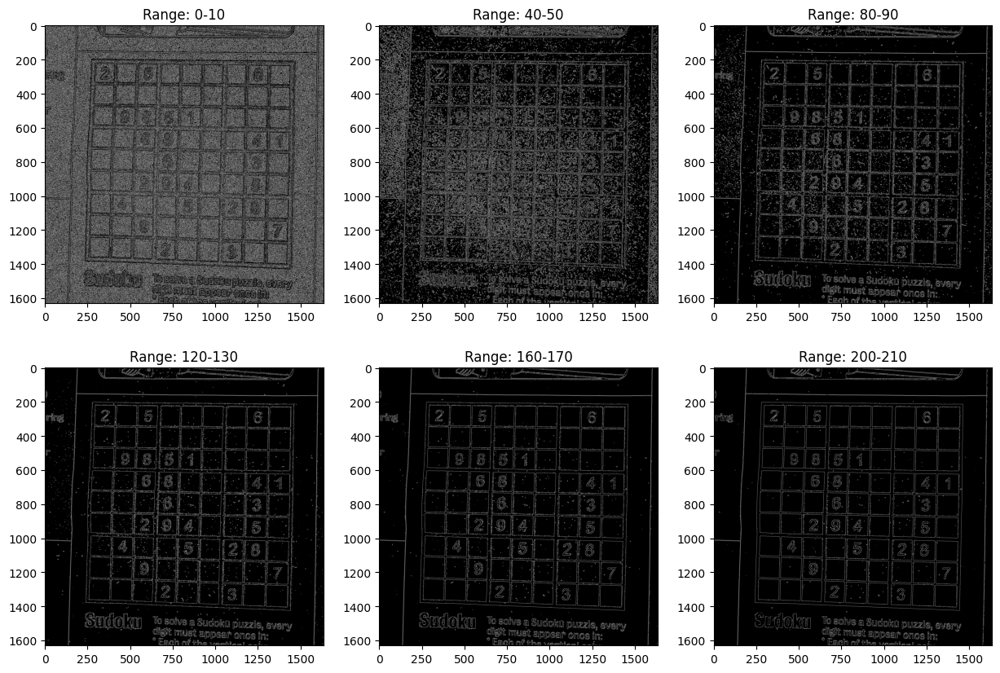

In [44]:
lows = [0,40,80,120,160,200]

plt.figure(figsize=[15,10])

x=1

for intensity in lows:
    plt.subplot(2,3,x)
    plt.imshow(cv2.Canny(img, intensity, intensity+10), cmap="gray")
    plt.title("Range: {}-{}".format(intensity, intensity + 10))
    x+=1

### Contours

Number of Contours found = 9


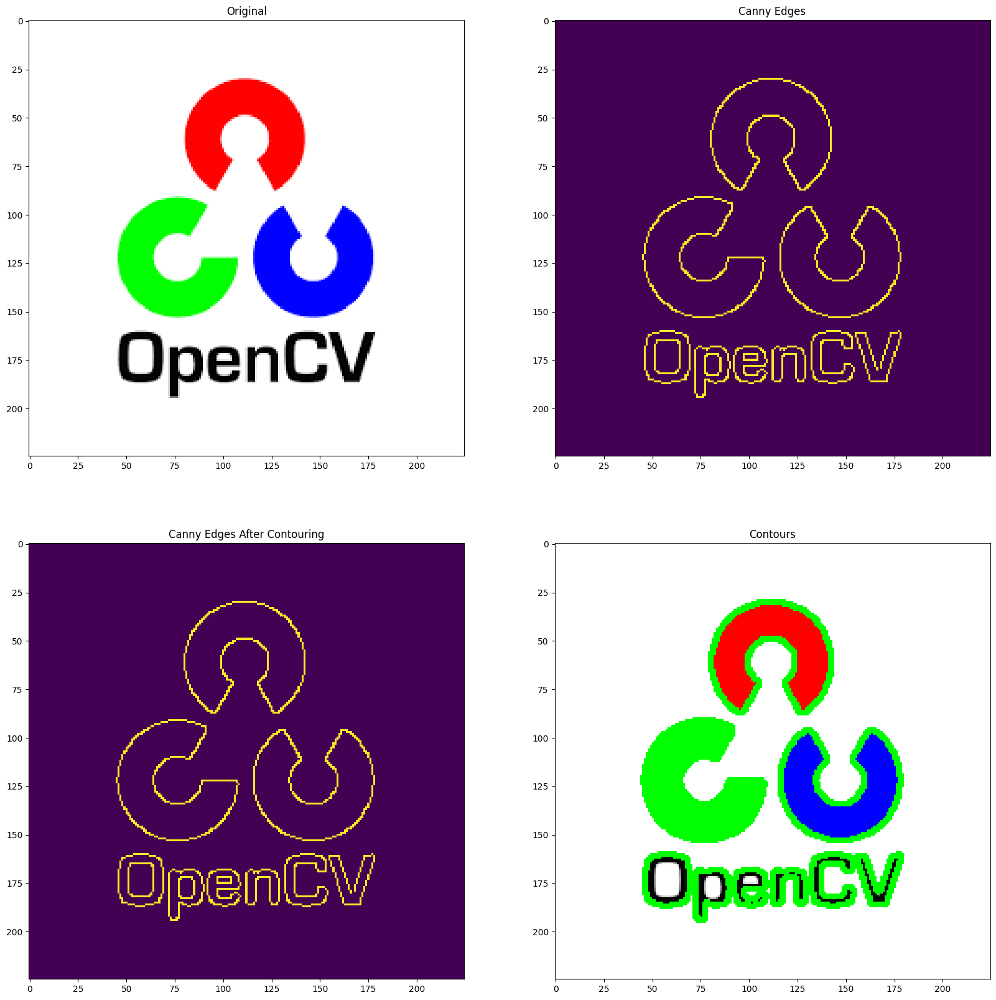

In [45]:
image = cv2.imread('/kaggle/input/sampleopencvmediafiles/media/opencv.png')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 20))

plt.subplot(2, 2, 1); plt.title("Original"); plt.imshow(image)

# Grayscale
gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
edged = cv2.Canny(gray, 30, 200)  # Find Canny edges
plt.subplot(2, 2, 2); plt.title("Canny Edges"); plt.imshow(edged)


# Finding Contours
# Use a copy of your image e.g. edged.copy(), since findContours alters the image
contours, hierarchy = cv2.findContours(edged, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

plt.subplot(2, 2, 3); plt.title("Canny Edges After Contouring"); plt.imshow(edged)

print("Number of Contours found = " + str(len(contours)))

# Draw all contours
# Use '-1' as the 3rd parameter to draw all
cv2.drawContours(image, contours, -1, (0,255,0), 2)

plt.subplot(2, 2, 4); plt.title("Contours"); plt.imshow(image)

<a id="9"></a> 
# **9. Image enhancement**

### Adjust brightness (addition)

Text(0.5, 1.0, 'Dark Image')

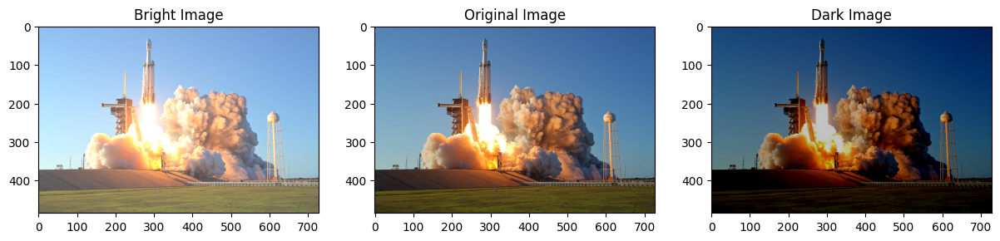

In [46]:
matrix = np.ones(falcon9.shape, dtype="uint8") + 60

brightImage = cv2.add(falcon9, matrix)
darkImage = cv2.subtract(falcon9, matrix)

plt.figure(figsize=[20,5])
plt.subplot(141); plt.imshow(brightImage); plt.title("Bright Image")
plt.subplot(142); plt.imshow(falcon9); plt.title("Original Image")
plt.subplot(143); plt.imshow(darkImage); plt.title("Dark Image")

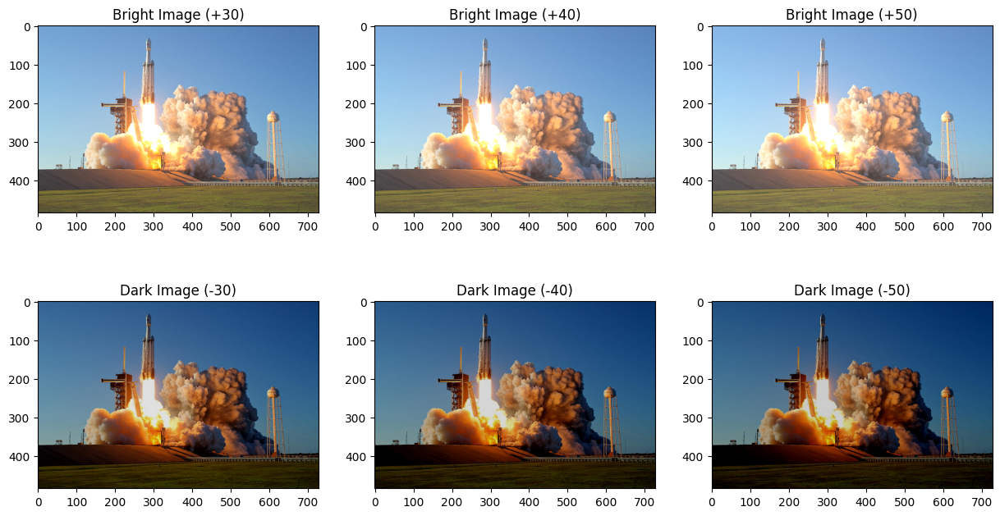

In [47]:
bright_matrix_values = [30, 40, 50]
dark_matrix_values = [30, 40, 50]

fig, axes = plt.subplots(2, 3, figsize=(15, 8))

for i, bright_value in enumerate(bright_matrix_values):
    bright_matrix = np.ones(falcon9.shape, dtype="uint8") + bright_value
    bright_image = cv2.add(falcon9, bright_matrix)
    
    axes[0, i].imshow(bright_image)
    axes[0, i].set_title(f"Bright Image (+{bright_value})")


for i, dark_value in enumerate(dark_matrix_values):
    dark_matrix = np.ones(falcon9.shape, dtype="uint8") + dark_value
    dark_image = cv2.subtract(falcon9, dark_matrix.astype('uint8')) 
    
    axes[1, i].imshow(dark_image)
    axes[1, i].set_title(f"Dark Image (-{dark_value})")

### Approximating Contours and Convex Hull

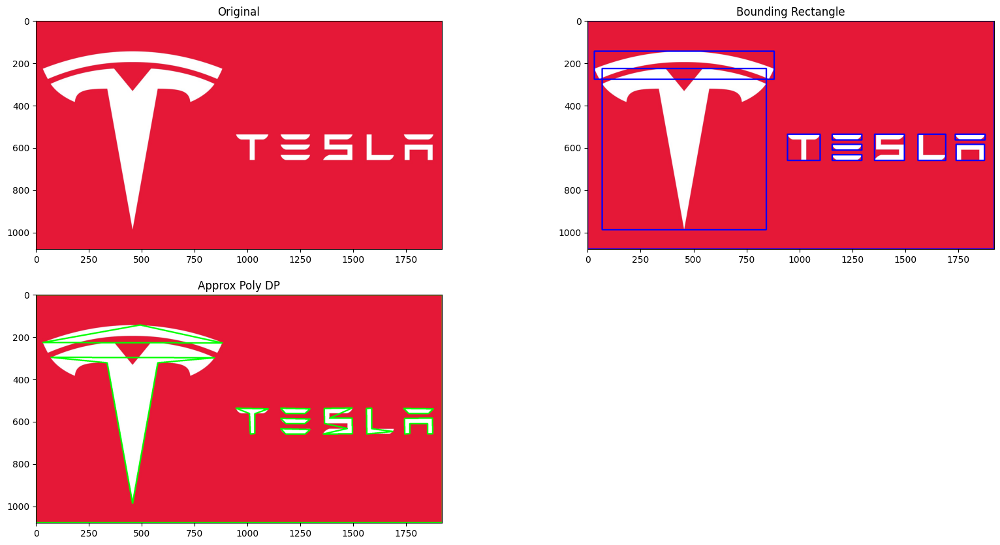

In [48]:
image = cv2.imread('/kaggle/input/sampleopencvmediafiles/media/tesla.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 10))

plt.subplot(2, 2, 1)
plt.title("Original")
plt.imshow(image)

orig_image = image.copy()


# Grayscale and binarize
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
ret, thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY_INV)

# Find contours 
contours, hierarchy = cv2.findContours(thresh.copy(), cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)

# Iterate through each contour and compute the bounding rectangle
for c in contours:
    x,y,w,h = cv2.boundingRect(c)
    cv2.rectangle(orig_image,(x,y),(x+w,y+h),(0,0,255),6)    
    plt.subplot(2, 2, 2)
    plt.title("Bounding Rectangle")
    plt.imshow(orig_image)

# cv2.waitKey(0) 
    
# Iterate through each contour and compute the approx contour
for c in contours:
    # Calculate accuracy as a percent of the contour perimeter
    accuracy = 0.03 * cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, accuracy, True)
    cv2.drawContours(image, [approx], 0, (0, 255, 0), 6)
    
    plt.subplot(2, 2, 3)
    plt.title("Approx Poly DP")
    plt.imshow(image)

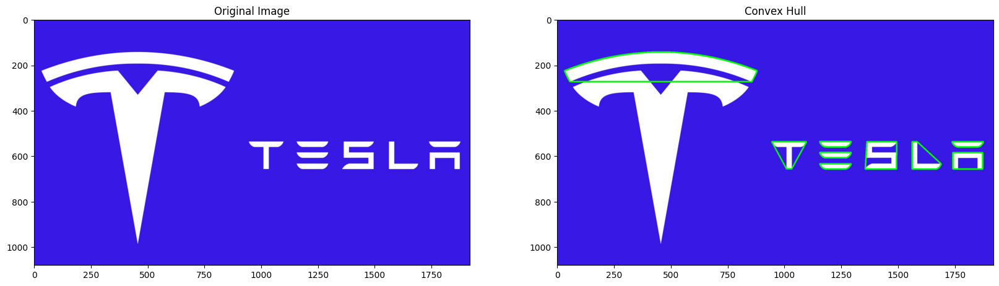

In [49]:
image = cv2.imread('/kaggle/input/sampleopencvmediafiles/media/tesla.jpg')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(20, 20))

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(image)

# Threshold the image
ret, thresh = cv2.threshold(gray, 176, 255, 0)

# Find contours 
contours, hierarchy = cv2.findContours(thresh.copy(), cv2.RETR_LIST, cv2.CHAIN_APPROX_NONE)
    
# Sort Contors by area and then remove the largest frame contour
n = len(contours) - 1
contours = sorted(contours, key=cv2.contourArea, reverse=False)[:n]

# Iterate through contours and draw the convex hull
for c in contours:
    hull = cv2.convexHull(c)
    cv2.drawContours(image, [hull], 0, (0, 255, 0), 6)

    plt.subplot(1, 2, 2)
    plt.title("Convex Hull")
    plt.imshow(image)

<a id="10"></a> 
# **10. Perpsective Transform**

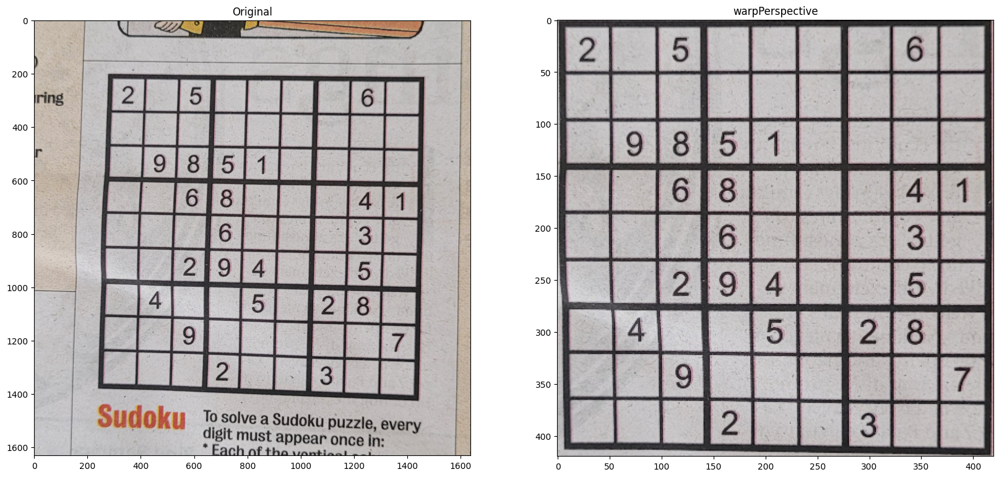

In [50]:
image = cv2.imread('/kaggle/input/sampleopencvmediafiles/media/img.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 20))

plt.subplot(1, 2, 1)
plt.title("Original")
plt.imshow(image)

# Cordinates of the 4 corners of the original image
points_A = np.float32([[275,200], [1470,215], [220,1400], [1450,1430]])

# Cordinates of the 4 corners of the desired output
# We use a ratio of an A4 Paper 1 : 1.41
points_B = np.float32([[0,0], [420,0], [0,420], [420,420]])
 
# Use the two sets of four points to compute 
# the Perspective Transformation matrix, M    
M = cv2.getPerspectiveTransform(points_A, points_B)
 
warped = cv2.warpPerspective(image, M, (420,420))

plt.subplot(1, 2, 2)
plt.title("warpPerspective")
plt.imshow(warped)

In [51]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  0


<a id="11"></a> 
# **11. Image filters - Blur, Features, CannyImage filters - Blur, Features, Canny**

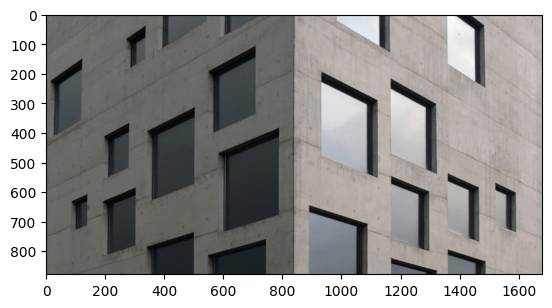

In [52]:
frame = cv2.imread("/kaggle/input/window/window.jpg")
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

plt.imshow(frame)

### 1. Blur

Text(0.5, 1.0, 'Blurred')

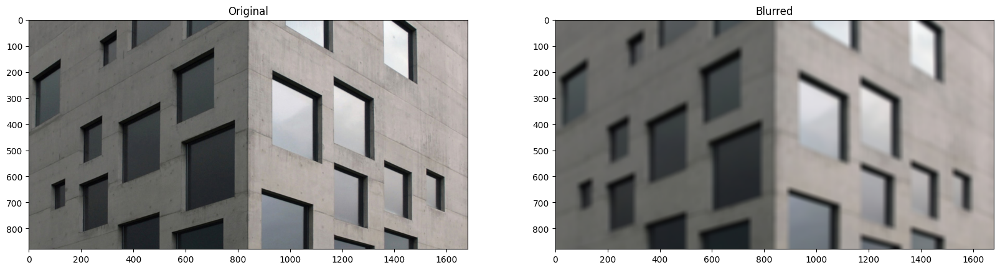

In [53]:
result = cv2.blur(frame, (23,23))

plt.figure(figsize=[20,10])
plt.subplot(1,2,1); plt.imshow(frame); plt.title("Original")
plt.subplot(1,2,2); plt.imshow(result); plt.title("Blurred")

### 2. Features

Text(0.5, 1.0, 'Features')

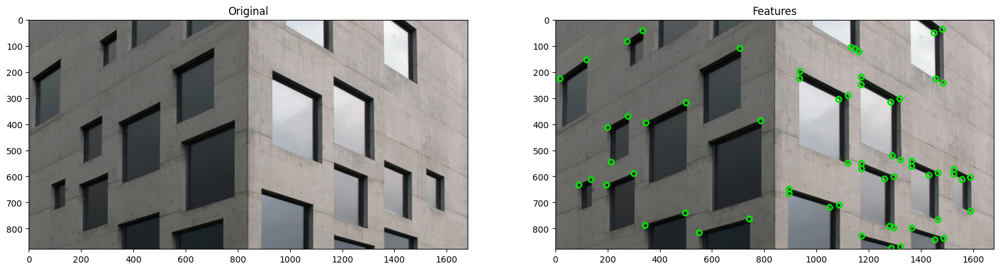

In [54]:
result = frame.copy()
feature_params = dict(maxCorners = 500,
                      qualityLevel = 0.2,
                      minDistance = 15,
                      blockSize = 9)

frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
corners = cv2.goodFeaturesToTrack(frame_gray, **feature_params)
if corners is not None:
    for x,y in np.float32(corners).reshape(-1,2):
        cv2.circle(result, (int(x), int(y)), 10, (0, 225, 0), 6)
    
plt.figure(figsize=[20,10])
plt.subplot(1,2,1); plt.imshow(frame); plt.title("Original")
plt.subplot(1,2,2); plt.imshow(result); plt.title("Features")

Text(0.5, 1.0, 'Features')

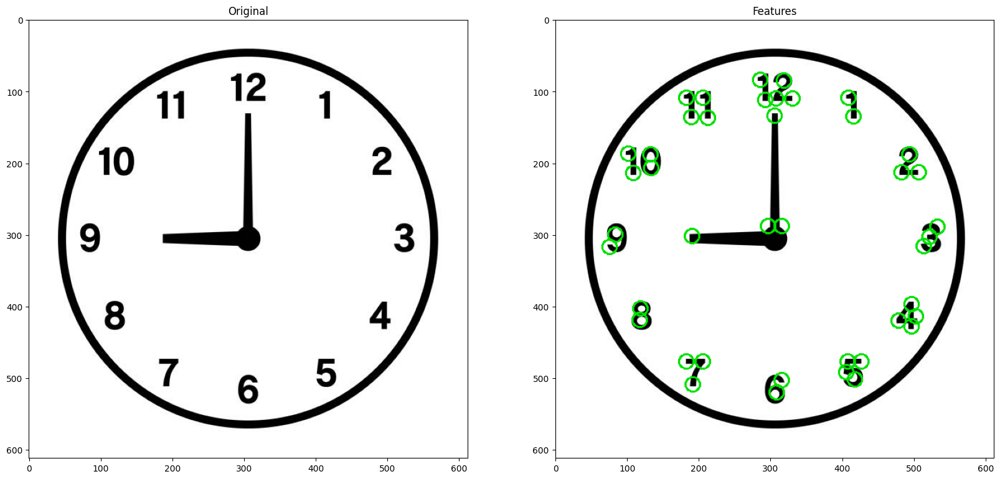

In [55]:
cb = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/clock.jpg")
cb_result = cb.copy()

cb_gray = cv2.cvtColor(cb, cv2.COLOR_BGR2GRAY)
corners = cv2.goodFeaturesToTrack(cb_gray, **feature_params)

if corners is not None:
    for x,y in np.float32(corners).reshape(-1,2):
        cv2.circle(cb_result, (int(x), int(y)), 10, (0, 225, 0), 2)
    
plt.figure(figsize=[20,10])
plt.subplot(1,2,1); plt.imshow(cb); plt.title("Original")
plt.subplot(1,2,2); plt.imshow(cb_result); plt.title("Features")

### 3. Canny

Text(0.5, 1.0, 'Canny edges')

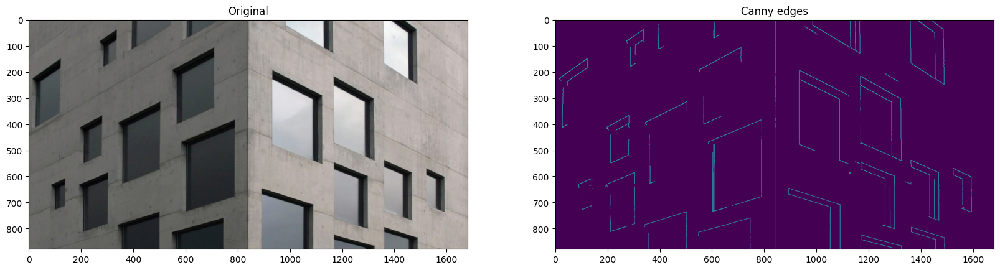

In [56]:
result = cv2.Canny(frame, 100,200)

plt.figure(figsize=[20,10])
plt.subplot(1,2,1); plt.imshow(frame); plt.title("Original")
plt.subplot(1,2,2); plt.imshow(result); plt.title("Canny edges")

<a id="12"></a> 
# **12. Image stiching**

<a id="14"></a> 
# **14. Bitwise operations**

There are 4 bitwise operators in opencv

- and
- or
- XOR
- not

In [57]:
image1 = cv2.imread("/kaggle/input/bitwise-operator/im1.png")
image2 = cv2.imread("/kaggle/input/bitwise-operator/im2.png")

bw_and = cv2.bitwise_and(image1.copy(), image2.copy())
bw_or = cv2.bitwise_or(image1.copy(), image2.copy())
bw_xor = cv2.bitwise_xor(image1.copy(), image2.copy())

Text(0.5, 1.0, 'Bitwise XOR operation')

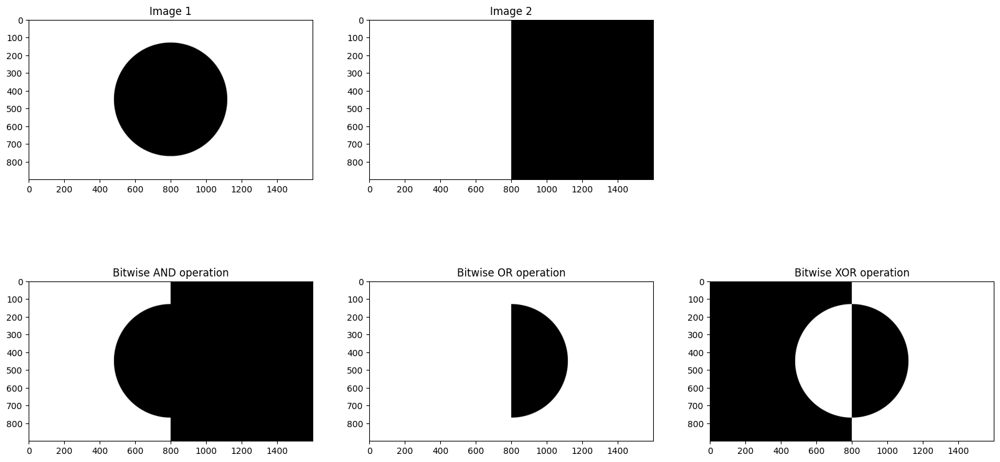

In [58]:
plt.figure(figsize=[20,10])

plt.subplot(2,3,1); plt.imshow(image1); plt.title("Image 1")
plt.subplot(2,3,2); plt.imshow(image2); plt.title("Image 2")
plt.subplot(2,3,4); plt.imshow(bw_and); plt.title("Bitwise AND operation")
plt.subplot(2,3,5); plt.imshow(bw_or); plt.title("Bitwise OR operation")
plt.subplot(2,3,6); plt.imshow(bw_xor); plt.title("Bitwise XOR operation")

Text(0.5, 1.0, 'Bitwise NOT Image 2')

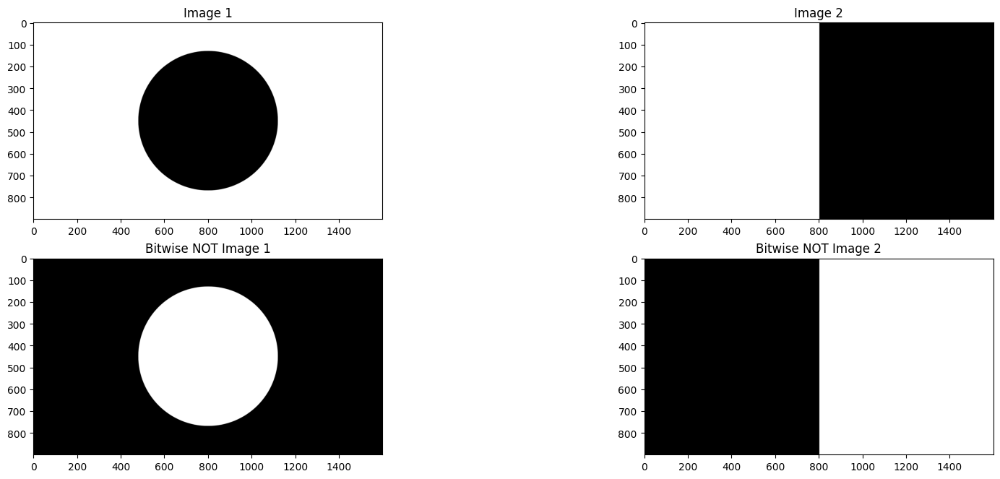

In [59]:
plt.figure(figsize=[20,12])

plt.subplot(3,2,1); plt.imshow(image1); plt.title("Image 1")
plt.subplot(3,2,3); plt.imshow(cv2.bitwise_not(image1)); plt.title("Bitwise NOT Image 1")
plt.subplot(3,2,2); plt.imshow(image2); plt.title("Image 2")
plt.subplot(3,2,4); plt.imshow(cv2.bitwise_not(image2)); plt.title("Bitwise NOT Image 2")

## Cool demonstration of bitwise operations

Text(0.5, 1.0, 'Forest')

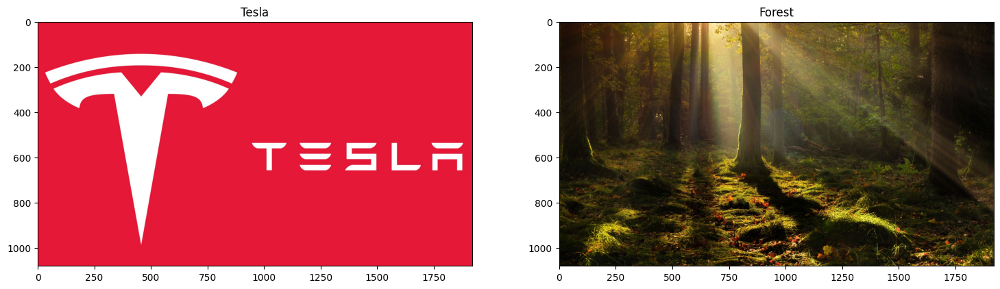

In [60]:
tesla_bgr = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/tesla.jpg")
tesla = cv2.cvtColor(tesla_bgr, cv2.COLOR_BGR2RGB)

forest_bgr = cv2.imread("/kaggle/input/sampleopencvmediafiles/media/forest.jpg")
forest = cv2.cvtColor(forest_bgr, cv2.COLOR_BGR2RGB)


# aspectRatio = tesla.shape[0] / forest.shape[1]
# dim = (tesla.shape[0], int(forest.shape[0] * aspectRatio))

# forest = cv2.resize(forest,dim,interpolation=cv2.INTER_AREA)

plt.figure(figsize=[18,5])
plt.subplot(121); plt.imshow(tesla); plt.title("Tesla")
plt.subplot(122); plt.imshow(forest); plt.title("Forest")

### Create mask for original image

THis can also be done using bitwise not operation, but I am using threshold technique

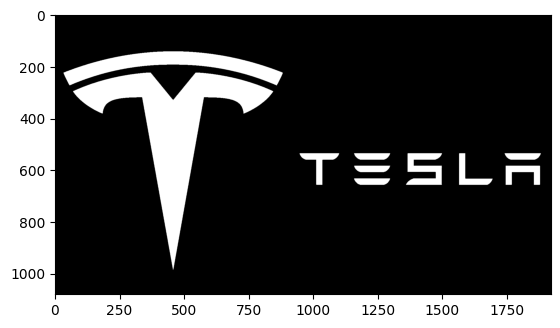

In [61]:
tesla_grey = cv2.cvtColor(tesla, cv2.COLOR_RGB2GRAY)

retval, tesla_mask = cv2.threshold(tesla_grey, 127, 255, cv2.THRESH_BINARY)
plt.imshow(tesla_mask, cmap="gray")

#### Invert the mask

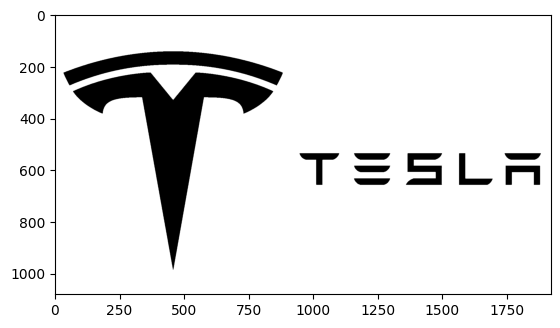

In [62]:
tesla_mask_inverted = cv2.bitwise_not(tesla_mask)
plt.imshow(tesla_mask_inverted, cmap="gray")

### Apply background to the mask¶

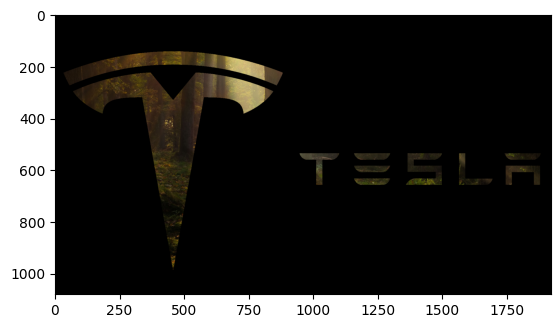

In [63]:
background = cv2.bitwise_and(forest, forest, mask=tesla_mask)
plt.imshow(background)

### solate foreground from the original image

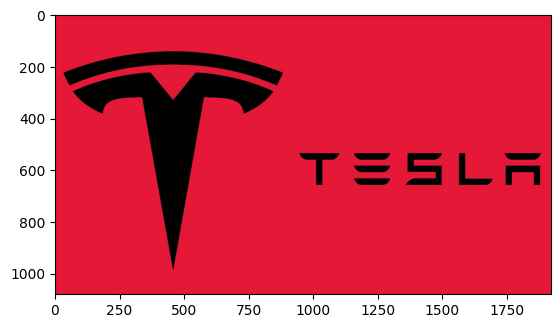

In [64]:
foreground = cv2.bitwise_and(tesla, tesla, mask=tesla_mask_inverted)
plt.imshow(foreground)

### Merge foreground and foreground

Text(0.5, 1.0, 'Result image')

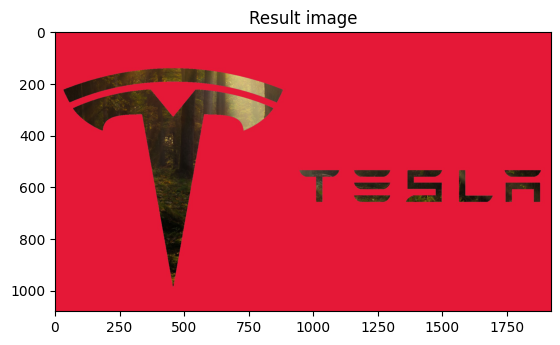

In [65]:
result = cv2.add(foreground, background)
plt.imshow(result); plt.title("Result image")

<a id="15"></a> 
# **15. Histogram Computation**

- Histogram computation in opencv allows us to visualise the colour intensities in an image with the help of histograms which gives us a high level intution on the pixle density in an image

- We can compute histograms for grayscale iamges and rgb images

In [66]:
rgbImage = falcon9.copy()
greyImage = cv2.cvtColor(falcon9, cv2.COLOR_RGB2GRAY)

Text(0.5, 1.0, 'Histogram')

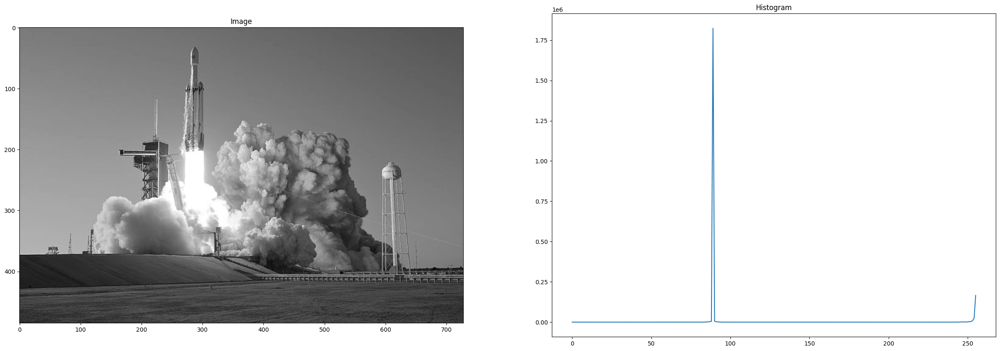

In [67]:
grayHist = cv2.calcHist([gray], [0], None, [256], [0,256])

plt.figure(figsize=[30,10])
plt.subplot(121); plt.imshow(greyImage, cmap="gray"); plt.title("Image")
plt.subplot(122); plt.plot(grayHist); plt.title("Histogram")

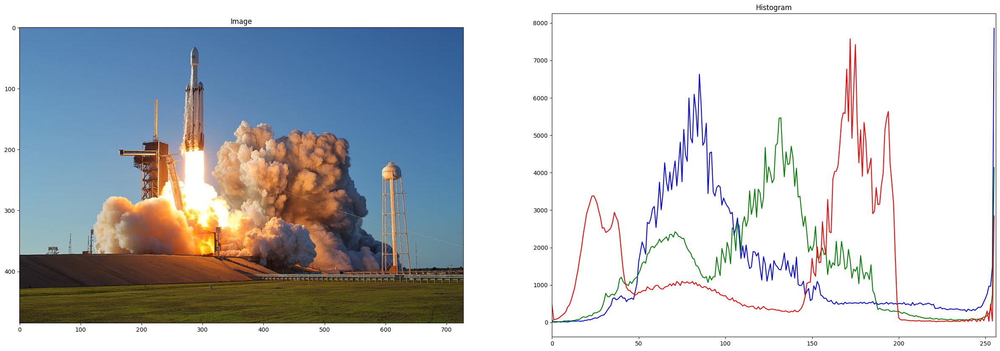

In [68]:
colors = ['b', 'g', 'r']

plt.figure(figsize=[30,10])
plt.subplot(121); plt.imshow(rgbImage, cmap="gray"); plt.title("Image")

for i, col in enumerate(colors):
    hist = cv2.calcHist([rgbImage], [i], None, [256], [0,256])
    plt.subplot(122); plt.plot(hist, color = col); plt.title("Histogram")
    plt.xlim([0,256])

<a id="16"></a> 
# **16. Line Detection**

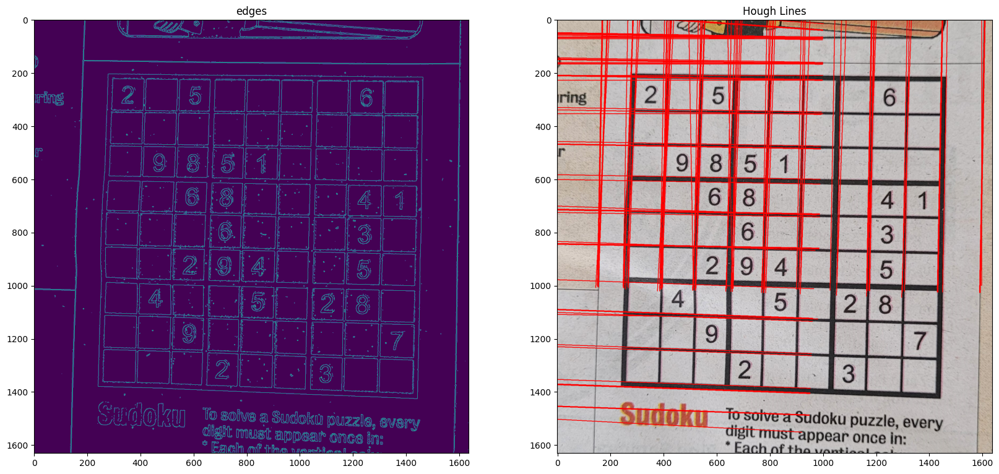

In [69]:
image = cv2.imread('/kaggle/input/sampleopencvmediafiles/media/img.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20, 20))

# Grayscale and Canny Edges extracted
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray, 170, 190, apertureSize = 3)

plt.subplot(2, 2, 1)
plt.title("edges")
plt.imshow(edges)

# Run HoughLines using a rho accuracy of 1 pixel
# theta accuracy of np.pi / 180 which is 1 degree
# Our line threshold is set to 240 (number of points on line)
lines = cv2.HoughLines(edges, 1, np.pi/180, 200)

# We iterate through each line and convert it to the format
# required by cv.lines (i.e. requiring end points)
for line in lines:
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)
    x0 = a * rho
    y0 = b * rho
    x1 = int(x0 + 1000 * (-b))
    y1 = int(y0 + 1000 * (a))
    x2 = int(x0 - 1000 * (-b))
    y2 = int(y0 - 1000 * (a))
    cv2.line(image, (x1, y1), (x2, y2), (255, 0, 0), 2)


plt.subplot(2, 2, 2)
plt.title("Hough Lines")
plt.imshow(image)